In [57]:
import warnings
from helper import *

In [58]:
# basic configuration
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", category=DeprecationWarning)
pd.set_option('display.max_columns', 500)

In [59]:
formatted_df = pd.read_csv("pipe_dataset.csv", index_col=0)
formatted_df.index = pd.to_datetime(formatted_df.index)
formatted_df.head()

,8705902546,8716113919,8718640762,8718640763,8718640787,8718645319,8718647378,8718649158,8718649167,8718649588,8718649589,8718651804,8718653366,8718654166,8718696020,8718696337,8718698387,8718699250,8719905826,8750306523
2021-09-26,102.0,102.0,2192.0,2168.0,2168.0,2352.0,2376.0,5547.0,5547.0,5371.0,3481.0,102.0,102.0,2376.0,102.0,102.0,102.0,102.0,2956.0,102.0
2021-10-03,2130.0,2130.0,2357.0,3253.0,3253.0,484.0,484.0,4800.0,4800.0,4800.0,2538.0,2130.0,2130.0,484.0,2130.0,2130.0,2130.0,2130.0,2064.0,2130.0
2021-10-10,1398.0,1758.0,4918.0,4842.0,4842.0,3196.0,3236.0,3426.0,3426.0,3426.0,2034.0,1758.0,1398.0,3236.0,1758.0,1758.0,1758.0,1758.0,3205.0,1758.0
2021-10-17,600.0,654.0,2897.0,2537.0,2537.0,4774.0,4782.0,7874.0,7874.0,7874.0,1902.0,654.0,600.0,4782.0,654.0,654.0,654.0,654.0,1444.0,654.0
2021-10-24,2190.0,2748.0,860.0,1308.0,1308.0,5556.0,5556.0,7025.0,7025.0,7025.0,3791.0,2748.0,2190.0,5556.0,2748.0,2748.0,2748.0,2748.0,2154.0,2748.0


In [60]:
from statsmodels.tsa.seasonal import seasonal_decompose

configure_matplotlib(transparent=False)
for i in range(0, len(formatted_df.columns)):
    selected_pipe = formatted_df.columns[i]
    seasons = seasonal_decompose(formatted_df[selected_pipe], model='additive', period=7, filt=None, two_sided=True, extrapolate_trend=0)
    ax = plt.subplot(len(formatted_df.columns), 1, i + 1)
    ax.figure.set_size_inches(20, i * 3)
    ax.figure.set_dpi(300)
    seasons.seasonal.plot(ax=ax, legend=False, marker='o', markersize=7, linewidth=2)
    ax.set_title(f"Pipe TTNr: {formatted_df.columns[i]}", fontsize=16)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.margins(x=40)
    plt.subplots_adjust(hspace=1, wspace=0)
    
plt.show()

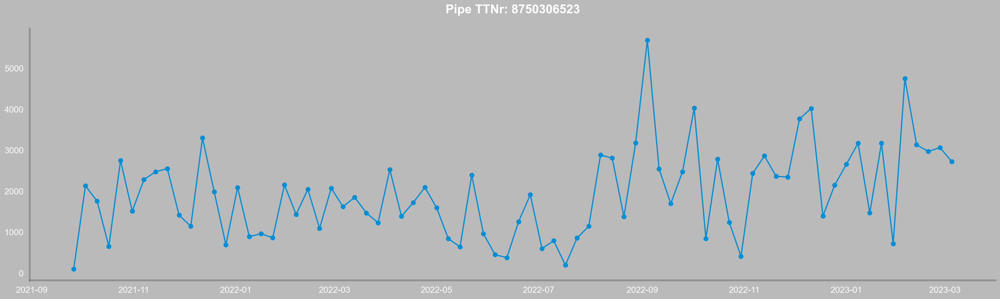

In [61]:
plt.figure(figsize=(25, 7))
plt.title(f"Pipe TTNr: {formatted_df.columns[i]}", fontsize=20)
plt.plot(formatted_df[formatted_df.columns[i]], marker='o', markersize=7, linewidth=2)
plt.show()

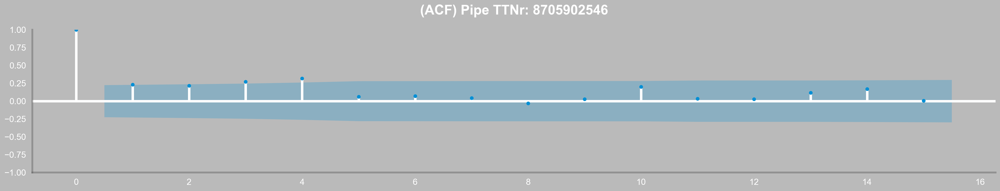

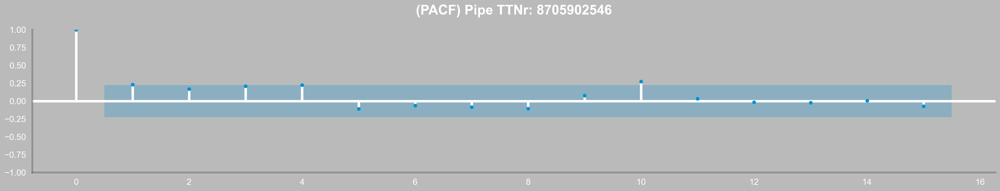

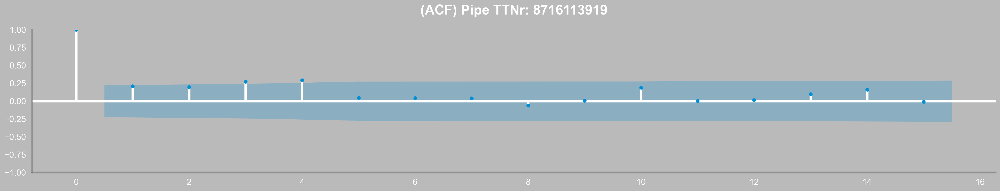

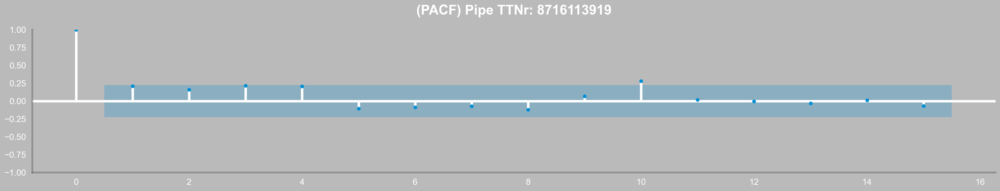

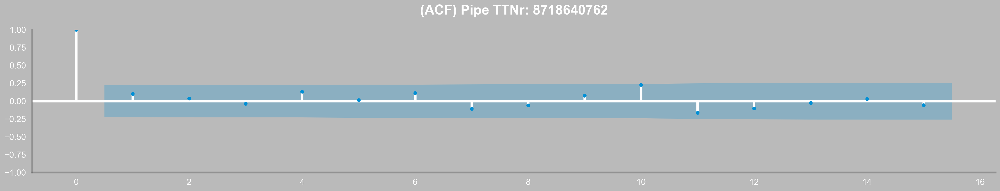

...

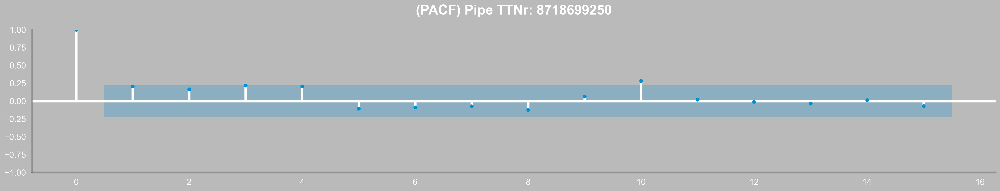

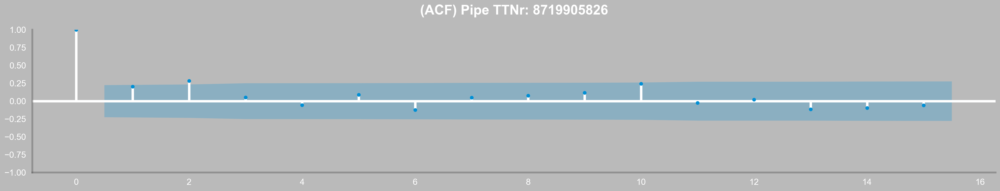

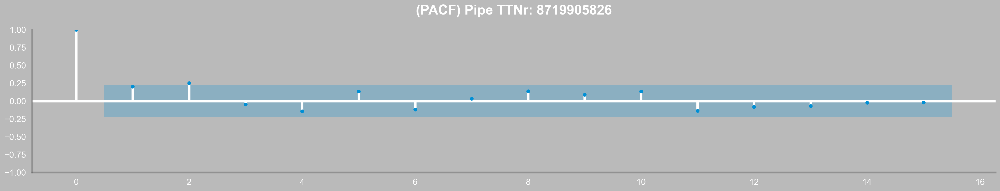

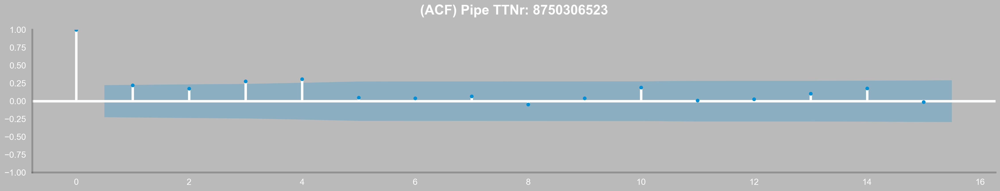

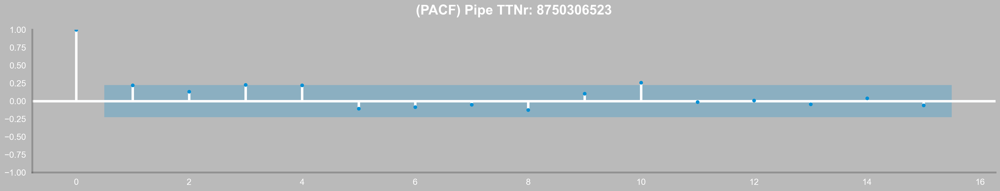

In [62]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

for i in range(len(formatted_df.columns)):
    fig, ax = plt.subplots(figsize=(25, 4))
    plot_acf(formatted_df[formatted_df.columns[i]], lags=15, ax=ax, title=f"(ACF) Pipe TTNr: {formatted_df.columns[i]}")

    fig, ax = plt.subplots(figsize=(25, 4))
    plot_pacf(formatted_df[formatted_df.columns[i]], lags=15, ax=ax, title=f"(PACF) Pipe TTNr: {formatted_df.columns[i]}")        

In [63]:
from sklearn.metrics import mean_squared_error, mean_absolute_error


def create_arima_model(df: pd.DataFrame,
                       selected_pipe: str,
                       m: int = 14,
                       model_type: str = "sarimax",
                       max_p: int = 3,
                       max_q: int = 3,
                       trace: bool = True,
                       test: str = "adf"):
    # find the best parameters
    params = auto_arima(df[selected_pipe],
                        start_p=1, start_q=1,
                        test=test,
                        max_p=max_p, max_q=max_q,
                        m=m,
                        d=None,
                        seasonal=True,
                        start_P=0,
                        D=1,
                        trace=trace,
                        error_action='ignore',
                        suppress_warnings=True,
                        stepwise=True,
                        random_state=42,
                        n_fits=10,
                        n_jobs=-1)

    # create the model
    if model_type == "arima":
        model = ARIMA(df[selected_pipe],
                      order=params.order,
                      seasonal_order=params.seasonal_order)
    elif model_type == "sarimax":
        model = SARIMAX(df[selected_pipe],
                        order=params.order,
                        seasonal_order=params.seasonal_order,
                        enforce_stationarity=False,
                        enforce_invertibility=False)
    else:
        raise ValueError("model_type must be either 'arima' or 'sarimax'")

    # fit the model
    fitted = model.fit(disp=0)

    # make predictions
    predictions = fitted.predict(n_periods=7, alpha=0.05)

    # make as pandas series
    fc_series = pd.Series(predictions, index=df.index)

    # calculate the confidence intervals
    confidence_interval = fitted.conf_int(alpha=0.05)
    lower_series = pd.Series(confidence_interval.iloc[:, 0], index=df.index)
    upper_series = pd.Series(confidence_interval.iloc[:, 1], index=df.index)

    # calculate error with different metrics
    rmse = np.sqrt(mean_squared_error(df[selected_pipe], fc_series))
    mae = mean_absolute_error(df[selected_pipe], fc_series)
    mape = np.mean(np.abs(fc_series - df[selected_pipe]) / np.abs(df[selected_pipe])) * 100
    mase = np.mean(np.abs(df[selected_pipe] - fc_series))
    errors = {"rmse": rmse, "mae": mae, "mape": mape, "mase": mase}

    return fc_series, lower_series, upper_series, fitted, errors, params.order, params.seasonal_order

In [64]:
def get_best_parameters(rmse_list: dict, 
                        mae_list: dict, 
                        mape_list: dict, 
                        mase_list: dict,
                        best_performers: dict,
                        pipe: str,
                        order_dict: dict,
                        seasonal_order_dict: dict):
    rmse_list = {k: v for k, v in sorted(rmse_list.items(), key=lambda item: item[1])}
    mae_list = {k: v for k, v in sorted(mae_list.items(), key=lambda item: item[1])}
    mape_list = {k: v for k, v in sorted(mape_list.items(), key=lambda item: item[1])}
    mase_list = {k: v for k, v in sorted(mase_list.items(), key=lambda item: item[1])}

    if pipe not in best_performers.keys():
        best_performers[pipe] = {'rmse': None, 'mae': None, 'mape': None, 'mase': None, 'order': {'rmse': None, 'mae': None, 'mape': None, 'mase': None}, 'seasonal_order': {'rmse': None, 'mae': None, 'mape': None, 'mase': None}}

    # root mean squared error, mean absolute error, mean absolute percentage error, mean absolute scaled error
    # aic = akaike information criterion 
    # bic = bayesian information criterion

    best_performers[pipe]['rmse'] = list(rmse_list.keys())[0]
    best_performers[pipe]['mae'] = list(mae_list.keys())[0]
    best_performers[pipe]['mape'] = list(mape_list.keys())[0]
    best_performers[pipe]['mase'] = list(mase_list.keys())[0]
    best_performers[pipe]['order']['rmse'] = order_dict[list(rmse_list.keys())[0]]
    best_performers[pipe]['order']['mae'] = order_dict[list(mae_list.keys())[0]]
    best_performers[pipe]['order']['mape'] = order_dict[list(mape_list.keys())[0]]
    best_performers[pipe]['order']['mase'] = order_dict[list(mase_list.keys())[0]]
    best_performers[pipe]['seasonal_order']['rmse'] = seasonal_order_dict[list(rmse_list.keys())[0]]
    best_performers[pipe]['seasonal_order']['mae'] = seasonal_order_dict[list(mae_list.keys())[0]]
    best_performers[pipe]['seasonal_order']['mape'] = seasonal_order_dict[list(mape_list.keys())[0]]
    best_performers[pipe]['seasonal_order']['mase'] = seasonal_order_dict[list(mase_list.keys())[0]]

    return best_performers

In [65]:
from tqdm import tqdm

models, fc_series_dict, lower_series_dict, upper_series_dict, rmse_dict = {}, {}, {}, {}, {}
rmse_list, mae_list, mape_list, mase_list = {}, {}, {}, {}
best_performers = {}
order_dict, seasonal_order_dict = {}, {}
pipe_counter = 0

outer_loop = tqdm(formatted_df.columns, desc=f'Pipe TTNr: {formatted_df.columns[pipe_counter]}', total=len(formatted_df.columns), ncols=100)

for pipe in outer_loop:
    for i in range(6, 16):
        fc_series, lower_series, upper_series, fitted, errors, order, seasonal_order = create_arima_model(df=formatted_df, 
                                                                                                          selected_pipe=pipe, 
                                                                                                          m=i,
                                                                                                          test="adf",
                                                                                                          model_type="sarimax",
                                                                                                          max_p=10, max_q=10,
                                                                                                          trace=False)
        rmse_list[i], mae_list[i], mape_list[i], mase_list[i] = errors["rmse"], errors["mae"], errors["mape"], errors["mase"]
        order_dict[i], seasonal_order_dict[i] = order, seasonal_order

    outer_loop.set_description(f'Pipe TTNr: {formatted_df.columns[pipe_counter]}', refresh=True)

    pipe_counter +=1
    best_parameters = get_best_parameters(rmse_list, mae_list, mape_list, mase_list, best_performers, pipe, order_dict, seasonal_order_dict)

Pipe TTNr: 8705902546:   5%|██                                      | 1/20 [02:05<39:42, 125.38s/it]


KeyboardInterrupt: 

In [ ]:
from pprint import pprint

pprint(best_performers)

In [ ]:
from pprint import pprint

pprint(best_performers)

{'8705902546': {'mae': 7,
                'mape': 14,
                'mase': 7,
                'order': {'mae': (2, 1, 1),
                          'mape': (0, 1, 1),
                          'mase': (2, 1, 1),
                          'rmse': (2, 1, 1)},
                'rmse': 7,
                'seasonal_order': {'mae': (1, 1, 1, 7),
                                   'mape': (0, 1, 1, 14),
                                   'mase': (1, 1, 1, 7),
                                   'rmse': (1, 1, 1, 7)}},
 '8716113919': {'mae': 14,
                'mape': 14,
                'mase': 14,
                'order': {'mae': (0, 1, 1),
                          'mape': (0, 1, 1),
                          'mase': (0, 1, 1),
                          'rmse': (3, 1, 0)},
                'rmse': 7,
                'seasonal_order': {'mae': (0, 1, 1, 14),
                                   'mape': (0, 1, 1, 14),
                                   'mase': (0, 1, 1, 14),
                   

In [ ]:
import json

with open('best_performing_periods.json', 'w') as fp:
    json.dump(best_performers, fp)

In [ ]:
with open('best_performing_periods.json', 'r') as fp:
    best_performers = json.load(fp)

In [ ]:
models, fc_series_dict, lower_series_dict, upper_series_dict, rmse_dict = {}, {}, {}, {}, {}
aic_values, bic_values = {}, {}

for pipe in tqdm(formatted_df.columns):
    fc_series, lower_series, upper_series, fitted, errors = create_arima_model(df=formatted_df, 
                                                                            selected_pipe=pipe, 
                                                                            m=best_performers[pipe]['mase'],
                                                                            test="adf",
                                                                            model_type="sarimax",
                                                                            max_p=10, max_q=10,
                                                                            trace=False)
    models[pipe], fc_series_dict[pipe], lower_series_dict[pipe] = fitted, fc_series, lower_series
    upper_series_dict[pipe], rmse_dict[pipe] = upper_series, errors["rmse"]
    
    aic_values[pipe] = fitted.aic
    bic_values[pipe] = fitted.bic
    
    print(f"Pipe TTNr: {pipe} - Period: {best_performers[pipe]} - RMSE: {errors['rmse']:.2f} - MAE: {errors['mae']:.2f} - MAPE: {errors['mape']:.2f} - MASE: {errors['mase']:.2f} - AIC: {aic_values[pipe]:.2f} - BIC: {bic_values[pipe]:.2f}")

  5%|▌         | 1/20 [00:06<01:55,  6.07s/it]

Pipe TTNr: 8705902546 - Period: {'rmse': 7, 'mae': 7, 'mape': 14, 'mase': 7} - RMSE: 1017.10 - MAE: 758.52 - MAPE: 64.37 - MASE: 758.52 - AIC: 996.93 - BIC: 1009.40


 10%|█         | 2/20 [00:10<01:29,  4.99s/it]

Pipe TTNr: 8716113919 - Period: {'rmse': 7, 'mae': 14, 'mape': 14, 'mase': 14} - RMSE: 1102.28 - MAE: 794.32 - MAPE: 63.20 - MASE: 794.32 - AIC: 767.06 - BIC: 772.48


 15%|█▌        | 3/20 [00:14<01:16,  4.52s/it]

Pipe TTNr: 8718640762 - Period: {'rmse': 6, 'mae': 10, 'mape': 6, 'mase': 10} - RMSE: 1114.31 - MAE: 819.90 - MAPE: 119.98 - MASE: 819.90 - AIC: 868.00 - BIC: 873.91


 20%|██        | 4/20 [00:17<01:06,  4.13s/it]

Pipe TTNr: 8718640763 - Period: {'rmse': 6, 'mae': 6, 'mape': 14, 'mase': 6} - RMSE: 1128.00 - MAE: 836.46 - MAPE: 65.58 - MASE: 836.46 - AIC: 1026.86 - BIC: 1033.29


 25%|██▌       | 5/20 [00:21<00:59,  3.97s/it]

Pipe TTNr: 8718640787 - Period: {'rmse': 6, 'mae': 6, 'mape': 14, 'mase': 6} - RMSE: 1128.00 - MAE: 836.46 - MAPE: 65.58 - MASE: 836.46 - AIC: 1026.86 - BIC: 1033.29


 30%|███       | 6/20 [00:28<01:11,  5.11s/it]

Pipe TTNr: 8718645319 - Period: {'rmse': 7, 'mae': 7, 'mape': 14, 'mase': 7} - RMSE: 1408.66 - MAE: 1065.49 - MAPE: 98.53 - MASE: 1065.49 - AIC: 911.67 - BIC: 921.62


 35%|███▌      | 7/20 [00:35<01:11,  5.49s/it]

Pipe TTNr: 8718647378 - Period: {'rmse': 7, 'mae': 7, 'mape': 14, 'mase': 7} - RMSE: 1418.46 - MAE: 1065.60 - MAPE: 97.62 - MASE: 1065.60 - AIC: 911.57 - BIC: 921.52


 40%|████      | 8/20 [00:36<00:50,  4.21s/it]

Pipe TTNr: 8718649158 - Period: {'rmse': 11, 'mae': 7, 'mape': 11, 'mase': 7} - RMSE: 1935.38 - MAE: 1480.88 - MAPE: 62.90 - MASE: 1480.88 - AIC: 1053.92 - BIC: 1060.15


 45%|████▌     | 9/20 [00:37<00:36,  3.35s/it]

Pipe TTNr: 8718649167 - Period: {'rmse': 11, 'mae': 7, 'mape': 11, 'mase': 7} - RMSE: 1935.38 - MAE: 1480.88 - MAPE: 62.90 - MASE: 1480.88 - AIC: 1053.92 - BIC: 1060.15


 50%|█████     | 10/20 [00:39<00:27,  2.75s/it]

Pipe TTNr: 8718649588 - Period: {'rmse': 11, 'mae': 7, 'mape': 11, 'mase': 7} - RMSE: 1908.22 - MAE: 1468.57 - MAPE: 62.88 - MASE: 1468.57 - AIC: 1054.06 - BIC: 1060.29


 55%|█████▌    | 11/20 [01:08<01:37, 10.79s/it]

Pipe TTNr: 8718649589 - Period: {'rmse': 11, 'mae': 15, 'mape': 14, 'mase': 15} - RMSE: 1226.83 - MAE: 909.11 - MAPE: 123.51 - MASE: 909.11 - AIC: 451.15 - BIC: 459.96


 60%|██████    | 12/20 [01:12<01:10,  8.76s/it]

Pipe TTNr: 8718651804 - Period: {'rmse': 11, 'mae': 14, 'mape': 14, 'mase': 14} - RMSE: 1109.80 - MAE: 796.56 - MAPE: 63.83 - MASE: 796.56 - AIC: 768.06 - BIC: 773.48


 65%|██████▌   | 13/20 [01:23<01:05,  9.29s/it]

Pipe TTNr: 8718653366 - Period: {'rmse': 7, 'mae': 7, 'mape': 14, 'mase': 7} - RMSE: 1002.98 - MAE: 758.43 - MAPE: 65.40 - MASE: 758.43 - AIC: 978.30 - BIC: 992.72


 70%|███████   | 14/20 [01:29<00:50,  8.47s/it]

Pipe TTNr: 8718654166 - Period: {'rmse': 7, 'mae': 7, 'mape': 14, 'mase': 7} - RMSE: 1418.46 - MAE: 1065.60 - MAPE: 97.62 - MASE: 1065.60 - AIC: 911.57 - BIC: 921.52


 75%|███████▌  | 15/20 [01:35<00:38,  7.79s/it]

Pipe TTNr: 8718696020 - Period: {'rmse': 11, 'mae': 14, 'mape': 14, 'mase': 14} - RMSE: 1109.80 - MAE: 796.56 - MAPE: 63.83 - MASE: 796.56 - AIC: 768.06 - BIC: 773.48


 80%|████████  | 16/20 [01:40<00:27,  6.93s/it]

Pipe TTNr: 8718696337 - Period: {'rmse': 11, 'mae': 14, 'mape': 14, 'mase': 14} - RMSE: 1109.80 - MAE: 796.56 - MAPE: 63.83 - MASE: 796.56 - AIC: 768.06 - BIC: 773.48


 85%|████████▌ | 17/20 [01:46<00:19,  6.46s/it]

Pipe TTNr: 8718698387 - Period: {'rmse': 11, 'mae': 14, 'mape': 14, 'mase': 14} - RMSE: 1109.80 - MAE: 796.56 - MAPE: 63.83 - MASE: 796.56 - AIC: 768.06 - BIC: 773.48


 90%|█████████ | 18/20 [01:50<00:11,  5.70s/it]

Pipe TTNr: 8718699250 - Period: {'rmse': 11, 'mae': 14, 'mape': 14, 'mase': 14} - RMSE: 1109.80 - MAE: 796.56 - MAPE: 63.83 - MASE: 796.56 - AIC: 768.06 - BIC: 773.48


 95%|█████████▌| 19/20 [01:53<00:05,  5.06s/it]

Pipe TTNr: 8719905826 - Period: {'rmse': 10, 'mae': 7, 'mape': 7, 'mase': 7} - RMSE: 1170.53 - MAE: 884.77 - MAPE: 133.86 - MASE: 884.77 - AIC: 899.82 - BIC: 909.76


100%|██████████| 20/20 [01:57<00:00,  5.88s/it]

Pipe TTNr: 8750306523 - Period: {'rmse': 14, 'mae': 14, 'mape': 14, 'mase': 14} - RMSE: 1077.30 - MAE: 785.69 - MAPE: 62.16 - MASE: 785.69 - AIC: 764.46 - BIC: 769.88


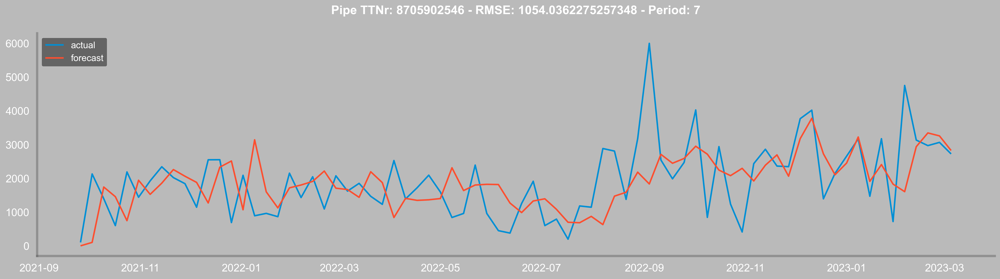

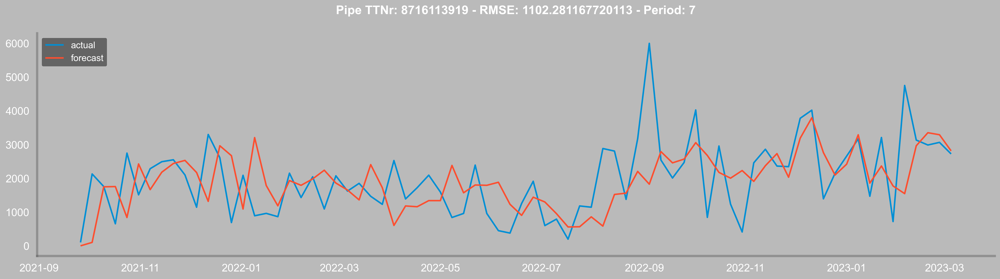

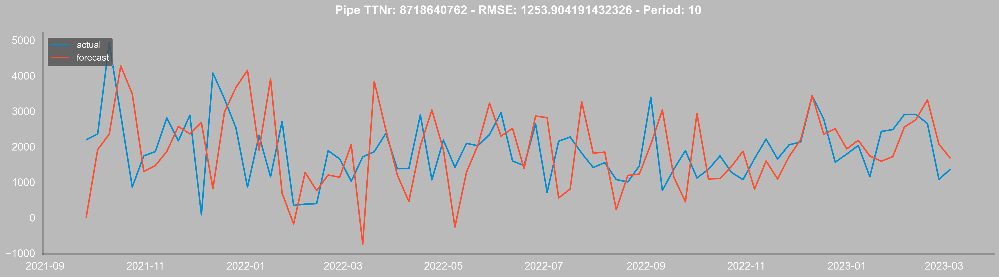

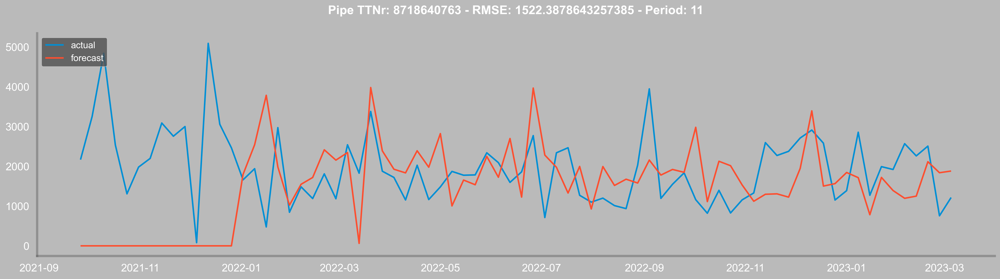

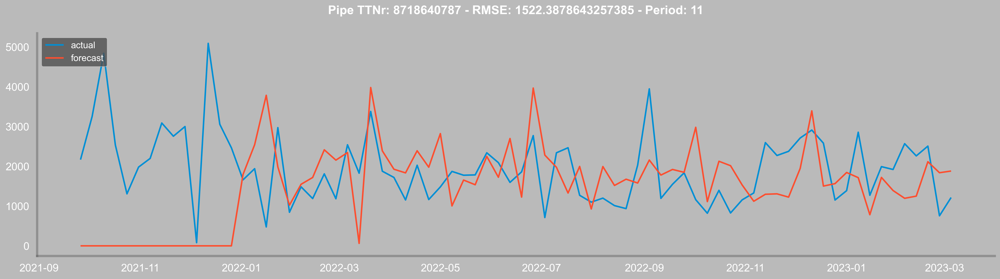

...

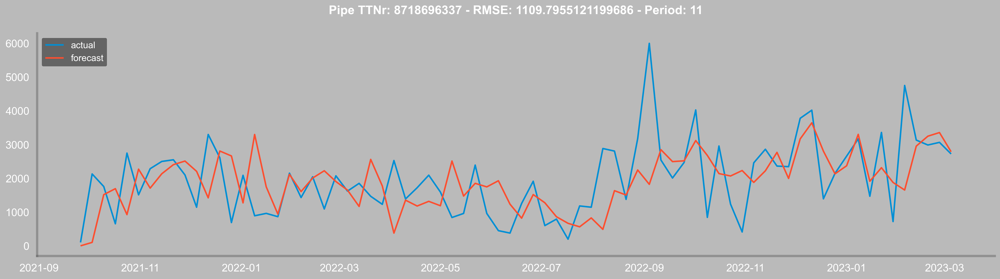

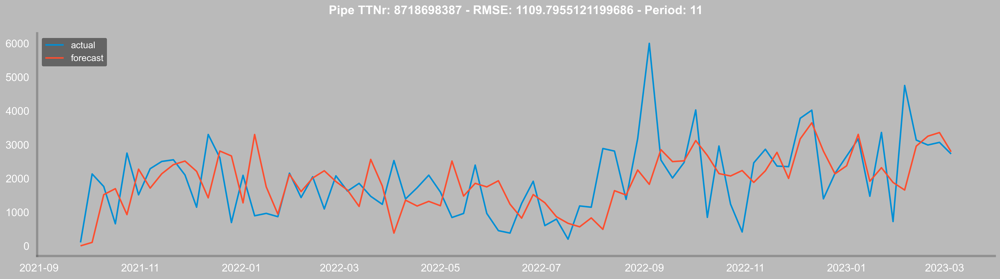

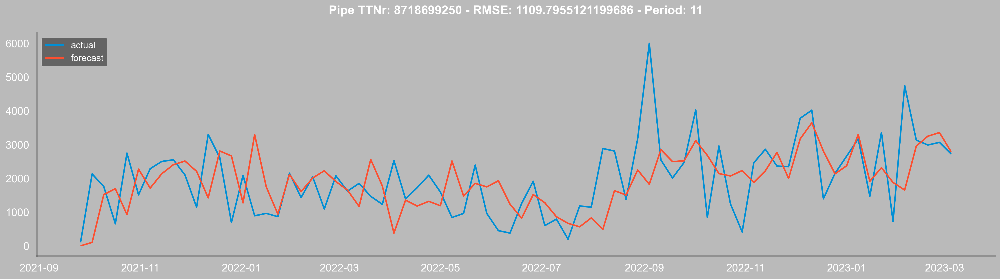

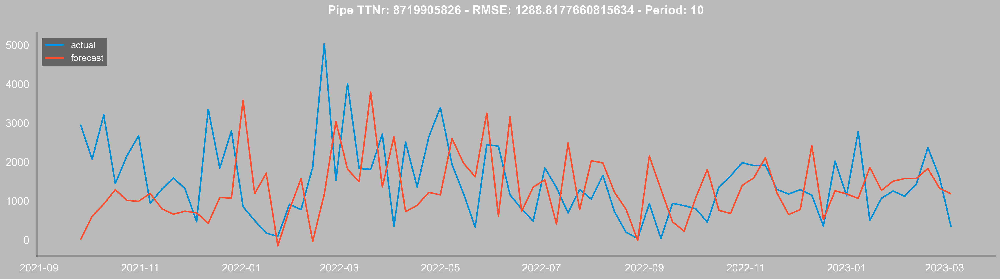

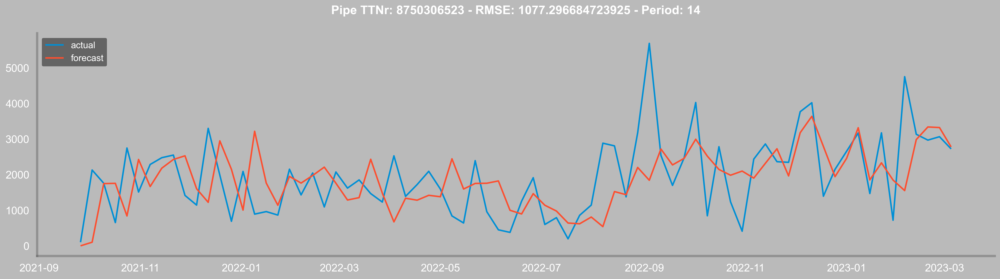

In [ ]:
# compare the predictions to the actual values
for pipe in formatted_df.columns:
    fc_series = fc_series_dict[pipe]
    lower_series = lower_series_dict[pipe]
    upper_series = upper_series_dict[pipe]
    plt.figure(figsize=(20, 5), dpi=300)
    plt.plot(formatted_df[pipe], label='actual', linewidth=2)
    plt.plot(fc_series, label='forecast', linewidth=2)
    plt.fill_between(lower_series.index, lower_series, upper_series, color='k', alpha=.15)
    plt.title(f"Pipe TTNr: {pipe} - RMSE: {rmse_dict[pipe]} - Period: {best_performers[pipe]}", fontsize=16)
    plt.legend(loc='upper left', fontsize=12)
    plt.show()

In [ ]:
configure_matplotlib()
for pipe_index, pipe in enumerate(formatted_df.columns):
    step = 15
    forecast = models[pipe].forecast(steps=step)
    forecast_df = pd.DataFrame(columns=[pipe], index=pd.date_range(start=formatted_df.index[-1] + pd.DateOffset(weeks=1), periods=step, freq='W-SUN'))
    forecast_df[pipe] = forecast

    # compare LSTM with actual values
    ax = plt.subplot(len(formatted_df.columns), 1, pipe_index + 1)
    ax.figure.set_size_inches(30, 10 if pipe_index == 0 else pipe_index * 10)

    # plot the actual and forecast values
    ax.set_title(f"Pipe TTNr: {pipe} - RMSE: {rmse_dict[pipe]:.2f} - Period: {best_performers[pipe]}")
    ax.plot(formatted_df[pipe], label='training', marker='o')
    ax.plot(forecast_df[pipe], label='forecast', marker='o')
    ax.plot([formatted_df.index[-1], forecast_df.index[0]], [formatted_df[pipe].iloc[-1], forecast_df[pipe].iloc[0]], marker='o')
    plt.subplots_adjust(hspace=0.6, wspace=0)
    ax.set_xticks([*formatted_df.index, *forecast_df.index])
    ax.margins(x=0.01)
    plt.xticks(rotation=90)
    
plt.show()